In [1]:
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt

%matplotlib inline

In [2]:
# data_path = "downloads"
data_path = "C://images"
if not os.path.exists(data_path):
    print("No data folder")
    exit()

matplotlib의 show에는 figure 갯수에 대한 기본적인 제한(120개)이 있는 것으로 보인다.

### 생각나는 것들 모아서 확인하는 용도였다

#### 여러 기법을 확인 중

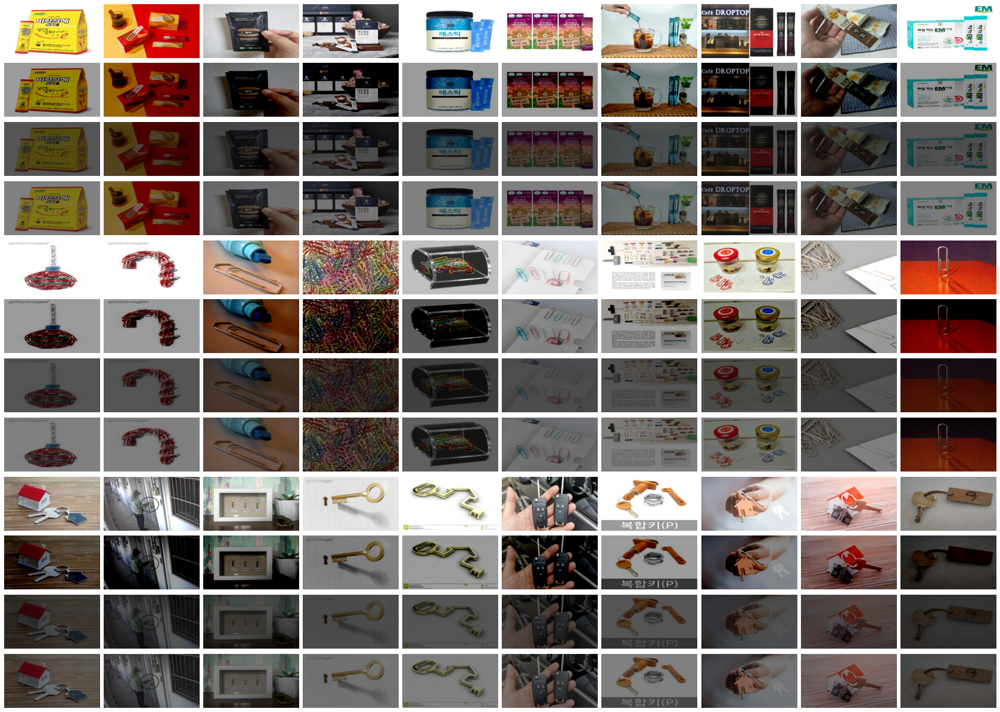

In [29]:
rows = 40
idx, times = 0, 3
plt.figure(figsize=(30, 22))
plt.subplots_adjust(hspace=0.01, wspace=0.04)

for folder in os.listdir(data_path):
    base_folder_path = os.path.join(data_path, folder)
    if os.path.isfile(base_folder_path):
        continue

    pictures = np.random.choice(os.listdir(base_folder_path), 10, replace=False)
    for n, p in enumerate(pictures):
        cols = 1
        img = cv2.imread(os.path.join(base_folder_path, p))

        ax = plt.subplot(times * 4, 10, idx * rows + cols + n)
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        ax.axis("off")
        cols += 10

        # ? 0. subtract
        # ax = plt.subplot(times * 4, 10, idx * rows + cols + n)
        # ax.imshow(cv2.cvtColor(cv2.subtract(img, np.full(img.shape, 100, dtype=np.uint8)), cv2.COLOR_BGR2RGB))
        # ax.axis("off")
        # cols += 10

        # ? 1. saturate
        ax = plt.subplot(times * 4, 10, idx * rows + cols + n)
        ax.imshow(cv2.cvtColor(np.clip(img - 100., 0, 255).astype(np.uint8), cv2.COLOR_BGR2RGB))
        ax.axis("off")
        cols += 10


        img = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(img)

        # ? 2. Histogram equalization
        # dst = cv2.equalizeHist(v)
        # img = cv2.merge((h, s, dst))
        # ax = plt.subplot(times * 4, 10, idx * rows + cols + n)
        # ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        # ax.axis("off")
        # cols += 10

        # ? 3. half
        # dst = 255 // 2 - v
        # img = cv2.merge((h, s, dst))
        # ax = plt.subplot(times * 4, 10, idx * rows + cols + n)
        # ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        # ax.axis("off")
        # cols += 10

        # ? 4. reverse
        # dst = 255 - v
        # img = cv2.merge((h, s, dst))
        # ax = plt.subplot(times * 4, 10, idx * rows + cols + n)
        # ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        # ax.axis("off")
        # cols += 10

        # ? 5. divide by three, a third, one-third
        dst = v // 3
        img = cv2.merge((h, s, dst))
        ax = plt.subplot(times * 4, 10, idx * rows + cols + n)
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        ax.axis("off")
        cols += 10

        # ? 6. normalization
        cv2.normalize(v, dst, 0, 256 // 2, cv2.NORM_MINMAX)
        img = cv2.merge((h, s, dst))
        ax = plt.subplot(times * 4, 10, idx * rows + cols + n)
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        ax.axis("off")
        cols += 10

        # cv2.normalize(v, dst, 0, 256 // 2, cv2.NORM_L1)
        # img = cv2.merge((h, s, dst))
        # ax = plt.subplot(times * 4, 10, idx * rows + cols + n)
        # ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        # ax.axis("off")
        # cols += 10
        
        # cv2.normalize(v, dst, 0, 256 // 2, cv2.NORM_L2)
        # img = cv2.merge((h, s, dst))
        # ax = plt.subplot(times * 4, 10, idx * rows + cols + n)
        # ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        # ax.axis("off")
        # cols += 10

        # cv2.normalize(v, dst, 0, 256 // 2, cv2.NORM_INF)
        # img = cv2.merge((h, s, dst))
        # ax = plt.subplot(times * 4, 10, idx * rows + cols + n)
        # ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        # ax.axis("off")
    idx += 1

#### 이전 실험을 통해 얻은 결과를 이용 중

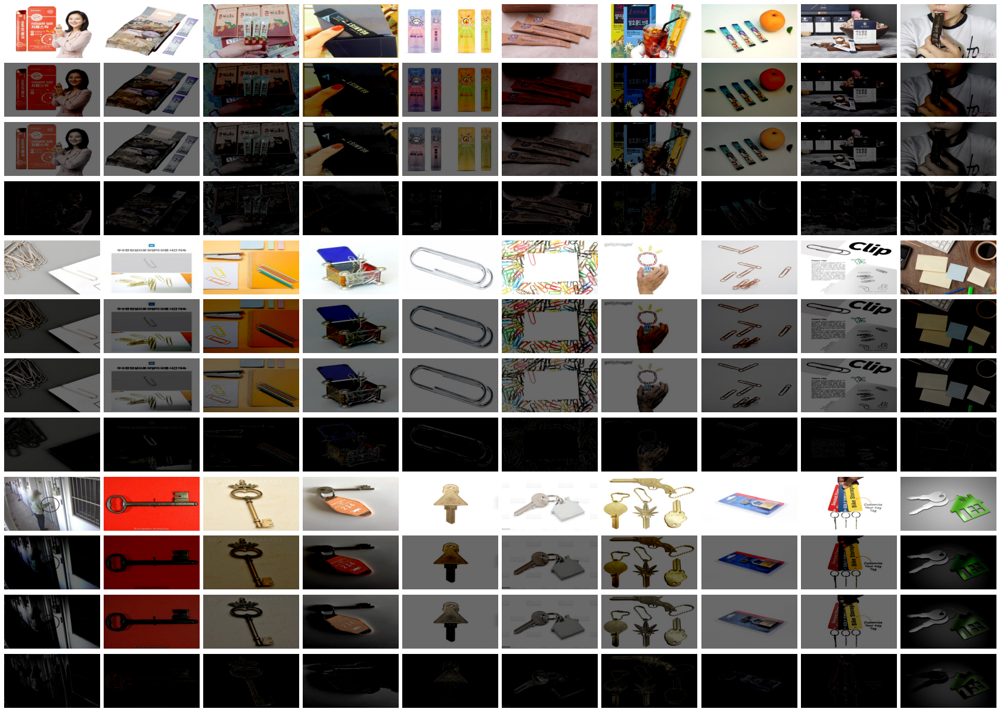

In [37]:
rows, cols = 40, 8
idx, times = 0, 3
plt.figure(figsize=(30, 22))
plt.subplots_adjust(hspace=0.01, wspace=0.04)

for folder in os.listdir(data_path):
    base_folder_path = os.path.join(data_path, folder)
    if os.path.isfile(base_folder_path):
        continue

    pictures = np.random.choice(os.listdir(base_folder_path), cols, replace=False)
    for n, p in enumerate(pictures):
        cols = 1
        base = cv2.imread(os.path.join(base_folder_path, p))

        ax = plt.subplot(times * 4, cols, idx * rows + cols + n)
        ax.imshow(cv2.cvtColor(base, cv2.COLOR_BGR2RGB))
        ax.axis("off")
        cols += 10

        # ? 1. RGB
        # ax = plt.subplot(times * 4, cols, idx * rows + cols + n)
        # ax.imshow(cv2.cvtColor(cv2.subtract(base, np.full(base.shape, 150, dtype=np.uint8)), cv2.COLOR_BGR2RGB))
        # ax.axis("off")
        # cols += 10

        # ? 2. HSV
        # img = cv2.cvtColor(base, cv2.COLOR_BGR2HSV)
        # h, s, v = cv2.split(img)
        # dst = cv2.subtract(v, np.full(v.shape, 150, dtype=np.uint8))
        # img = cv2.merge((h, s, dst))

        # ax = plt.subplot(times * 4, cols, idx * rows + cols + n)
        # ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        # ax.axis("off")
        # cols += 10

        # * 3. YCrCb 형광색으로 강조된다.
        # img = cv2.cvtColor(base, cv2.COLOR_BGR2YCrCb)
        # y, r, b = cv2.split(img)
        # dst = cv2.subtract(y, np.full(y.shape, 150, dtype=np.uint8))
        # img = cv2.merge((dst, r, b))

        # ax = plt.subplot(times * 4, cols, idx * rows + cols + n)
        # ax.imshow(cv2.cvtColor(img, cv2.COLOR_YCrCb2RGB))
        # ax.axis("off")
        # cols += 10

        # ? 4. 임의 값 조정
        # img = cv2.cvtColor(base, cv2.COLOR_BGR2HSV)
        # h, s, v = cv2.split(img)
        # dst = cv2.subtract(255 - v, np.full(v.shape, 100, dtype=np.uint8))
        # dst = v // 10
        # img = cv2.merge((h, s, dst))
        # dst = np.exp((np.array(v) - np.mean(np.array(v))) / np.std(np.array(v)))
        # dst = dst * 255 / np.max(dst.flatten()) - 100
        # img = cv2.merge((h, s, dst.astype(np.uint8)))

        # dst = (np.add(np.array(np.clip(v, 0, 200)), 56)).astype(np.uint8)
        # dst = cv2.subtract(dst, 55)
        # # dst = np.exp((dst - np.mean(np.array(dst))) / np.std(np.array(dst)))
        # # dst = dst * 200 / np.max(dst.flatten())
        # dst = cv2.subtract(dst, 150)
        # img = cv2.merge((h, s, dst.astype(np.uint8)))

        # ax = plt.subplot(times * 4, cols, idx * rows + cols + n)
        # ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        # ax.axis("off")

        # dst2 = dst * 255 / np.max(dst.flatten())
        # ax[3].hist(dst2.flatten(), bins=25)
        # ax[3].set_xlim(0, 255)
    idx += 1

### 특정 기법을 확인하고자 나눠놓았다

#### reverse

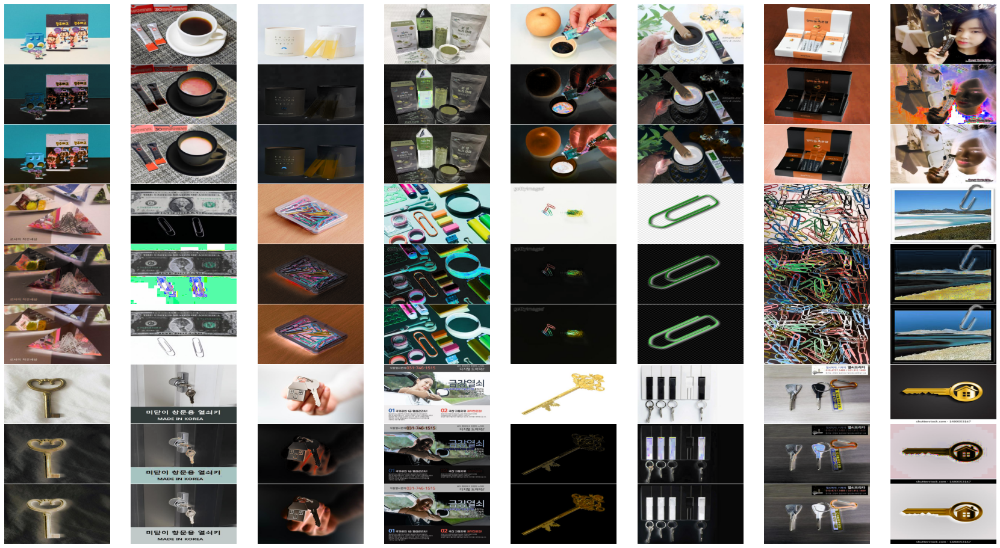

In [18]:
cols = 8
rows = 3 * cols
idx, times = 0, 3
plt.figure(figsize=(30, 22))
plt.subplots_adjust(hspace=0.01, wspace=0.04)

for folder in os.listdir(data_path):
    base_folder_path = os.path.join(data_path, folder)
    if os.path.isfile(base_folder_path):
        continue

    pictures = np.random.choice(os.listdir(base_folder_path), cols, replace=False)
    for n, p in enumerate(pictures):
        col = 1
        base = cv2.imread(os.path.join(base_folder_path, p))

        # * original
        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(base, cv2.COLOR_BGR2RGB))
        ax.axis("off")
        col += cols

        # * HSV
        morning = cv2.cvtColor(base, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(morning)
        dst = 255 - v
        img = cv2.merge((h, s, dst.astype(np.uint8)))

        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        ax.axis("off")
        col += cols

        # * YCbCr
        morning = cv2.cvtColor(base, cv2.COLOR_BGR2YCrCb)
        y, r, b = cv2.split(morning)
        dst = 255 - y
        img = cv2.merge((dst.astype(np.uint8), r, b))

        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_YCrCb2RGB))
        ax.axis("off")
    idx += 1

#### reverse - Standardization

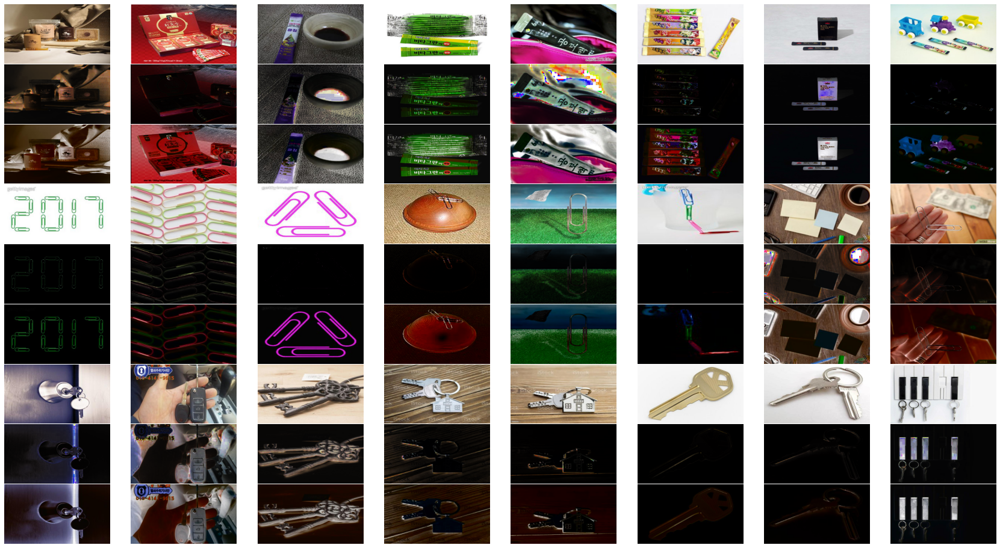

In [34]:
cols = 8
rows = 3 * cols
idx, times = 0, 3
plt.figure(figsize=(30, 22))
plt.subplots_adjust(hspace=0.01, wspace=0.04)

for folder in os.listdir(data_path):
    base_folder_path = os.path.join(data_path, folder)
    if os.path.isfile(base_folder_path):
        continue

    np.random.seed(246)
    pictures = np.random.choice(os.listdir(base_folder_path), cols, replace=False)
    for n, p in enumerate(pictures):
        col = 1
        base = cv2.imread(os.path.join(base_folder_path, p))

        # * original
        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(base, cv2.COLOR_BGR2RGB))
        ax.axis("off")
        col += cols

        # * HSV
        morning = cv2.cvtColor(base, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(morning)
        dst = 255 - v
        dst = np.exp((dst - np.mean(dst)) / np.std(dst))
        dst = dst * 255 / np.max(dst.flatten())
        img = cv2.merge((h, s, dst.astype(np.uint8)))

        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        ax.axis("off")
        col += cols

        # * YCbCr
        morning = cv2.cvtColor(base, cv2.COLOR_BGR2YCrCb)
        y, r, b = cv2.split(morning)
        dst = 255 - y
        dst = np.exp((dst - np.mean(dst)) / np.std(dst))
        dst = dst * 255 / np.max(dst.flatten())
        img = cv2.merge((dst.astype(np.uint8), r, b))

        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_YCrCb2RGB))
        ax.axis("off")
    idx += 1

#### Standardization output

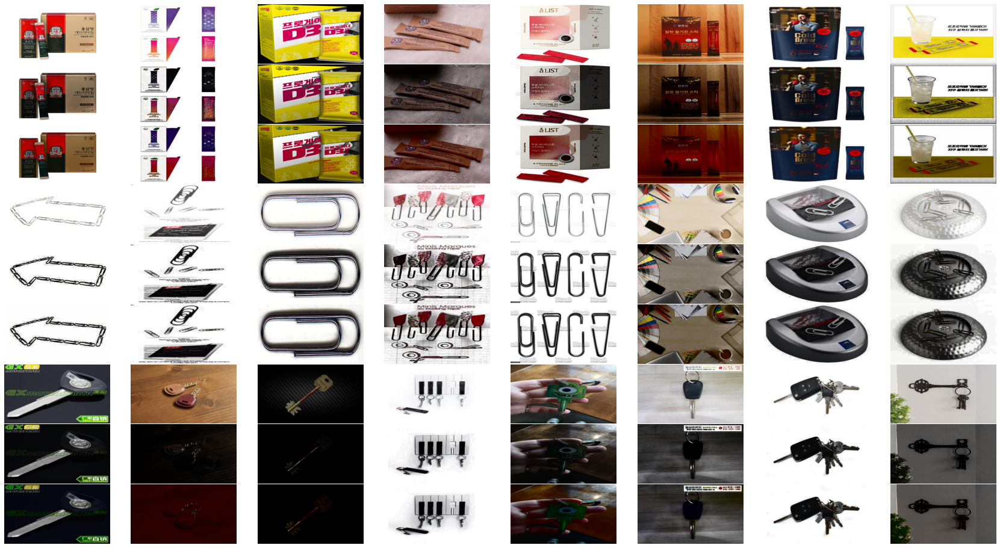

In [15]:
cols = 8
rows = 3 * cols
idx, times = 0, 3
plt.figure(figsize=(30, 22))
plt.subplots_adjust(hspace=0.01, wspace=0.04)

for folder in os.listdir(data_path):
    base_folder_path = os.path.join(data_path, folder)
    if os.path.isfile(base_folder_path):
        continue

    pictures = np.random.choice(os.listdir(base_folder_path), cols, replace=False)
    for n, p in enumerate(pictures):
        col = 1
        base = cv2.imread(os.path.join(base_folder_path, p))

        # * original
        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(base, cv2.COLOR_BGR2RGB))
        ax.axis("off")
        col += cols

        # * HSV
        morning = cv2.cvtColor(base, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(morning)
        dst = np.array(v)
        dst = np.exp((dst - np.mean(dst)) / np.std(dst))
        dst = dst * 255 / max(dst.flatten())
        img = cv2.merge((h, s, dst.astype(np.uint8)))

        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        ax.axis("off")
        col += cols

        # * YCbCr
        morning = cv2.cvtColor(base, cv2.COLOR_BGR2YCrCb)
        y, r, b = cv2.split(morning)
        dst = np.array(y)
        dst = np.exp((dst - np.mean(dst)) / np.std(dst))
        dst = dst * 255 / max(dst.flatten())
        img = cv2.merge((dst.astype(np.uint8), r, b))

        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_YCrCb2RGB))
        ax.axis("off")
    idx += 1

#### Subtract - Standardization

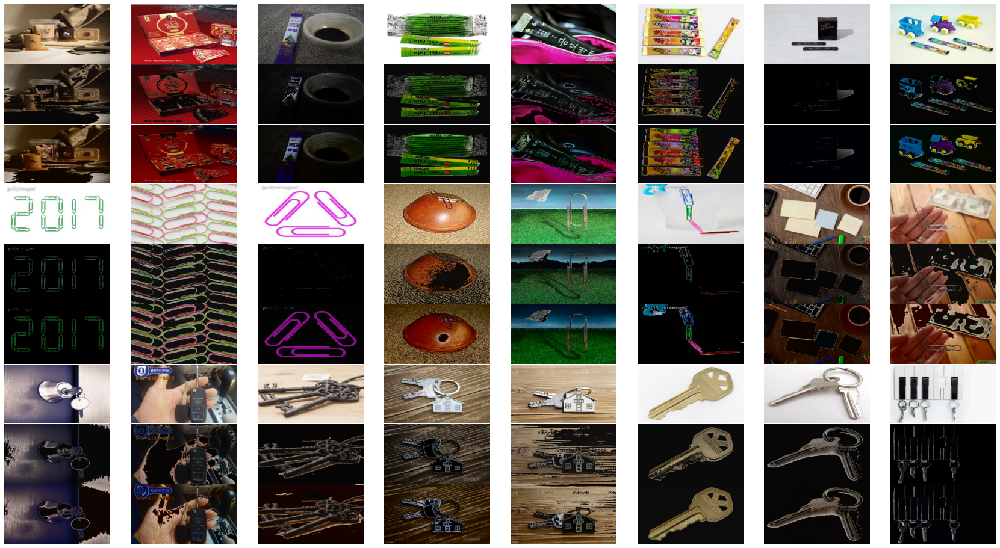

In [31]:
cols = 8
rows = 3 * cols
idx, times = 0, 3
plt.figure(figsize=(30, 22))
plt.subplots_adjust(hspace=0.01, wspace=0.04)

for folder in os.listdir(data_path):
    base_folder_path = os.path.join(data_path, folder)
    if os.path.isfile(base_folder_path):
        continue

    np.random.seed(246)
    pictures = np.random.choice(os.listdir(base_folder_path), cols, replace=False)
    for n, p in enumerate(pictures):
        col = 1
        base = cv2.imread(os.path.join(base_folder_path, p))

        # * original
        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(base, cv2.COLOR_BGR2RGB))
        ax.axis("off")
        col += cols

        # * HSV
        morning = cv2.cvtColor(base, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(morning)
        dst = np.add(v, 56).astype(np.uint8)
        dst = cv2.subtract(dst, 56)
        dst = np.exp((dst - np.mean(dst)) / np.std(dst))
        dst = dst * 180 / np.max(dst.flatten())
        img = cv2.merge((h, s, dst.astype(np.uint8)))

        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        ax.axis("off")
        col += cols

        # * YCbCr
        morning = cv2.cvtColor(base, cv2.COLOR_BGR2YCrCb)
        y, r, b = cv2.split(morning)
        dst = np.add(y, 56).astype(np.uint8)
        dst = cv2.subtract(dst, 56)
        dst = np.exp((dst - np.mean(dst)) / np.std(dst))
        dst = dst * 180 / np.max(dst.flatten())
        img = cv2.merge((dst.astype(np.uint8), r, b))

        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_YCrCb2RGB))
        ax.axis("off")
    idx += 1

#### reverse - Subtract - Standardization

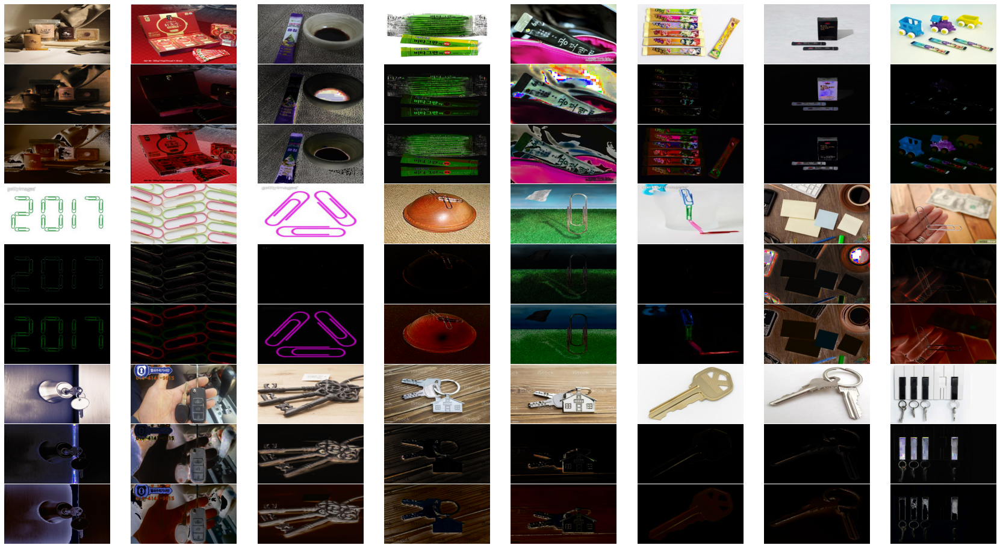

In [9]:
cols = 8
rows = 3 * cols
idx, times = 0, 3
plt.figure(figsize=(30, 22))
plt.subplots_adjust(hspace=0.01, wspace=0.04)

for folder in os.listdir(data_path):
    base_folder_path = os.path.join(data_path, folder)
    if os.path.isfile(base_folder_path):
        continue

    np.random.seed(246)
    pictures = np.random.choice(os.listdir(base_folder_path), cols, replace=False)
    for n, p in enumerate(pictures):
        col = 1
        base = cv2.imread(os.path.join(base_folder_path, p))

        # * original
        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(base, cv2.COLOR_BGR2RGB))
        ax.axis("off")
        col += cols

        # * HSV
        morning = cv2.cvtColor(base, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(morning)
        dst = np.add(255 - v, 30).astype(np.uint8)
        dst = cv2.subtract(dst, 30)
        dst = np.exp((dst - np.mean(dst)) / np.std(dst))
        dst = dst * 150 / np.max(dst.flatten())
        img = cv2.merge((h, s, dst.astype(np.uint8)))

        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        ax.axis("off")
        col += cols

        # * YCbCr
        morning = cv2.cvtColor(base, cv2.COLOR_BGR2YCrCb)
        y, r, b = cv2.split(morning)
        dst = np.add(255 - y, 30).astype(np.uint8)
        dst = cv2.subtract(dst, 30)
        dst = np.exp((dst - np.mean(dst)) / np.std(dst))
        dst = dst * 150 / np.max(dst.flatten())
        img = cv2.merge((dst.astype(np.uint8), r, b))

        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_YCrCb2RGB))
        ax.axis("off")
    idx += 1

### 기법은 정했고, 살짝 다듬은 수준

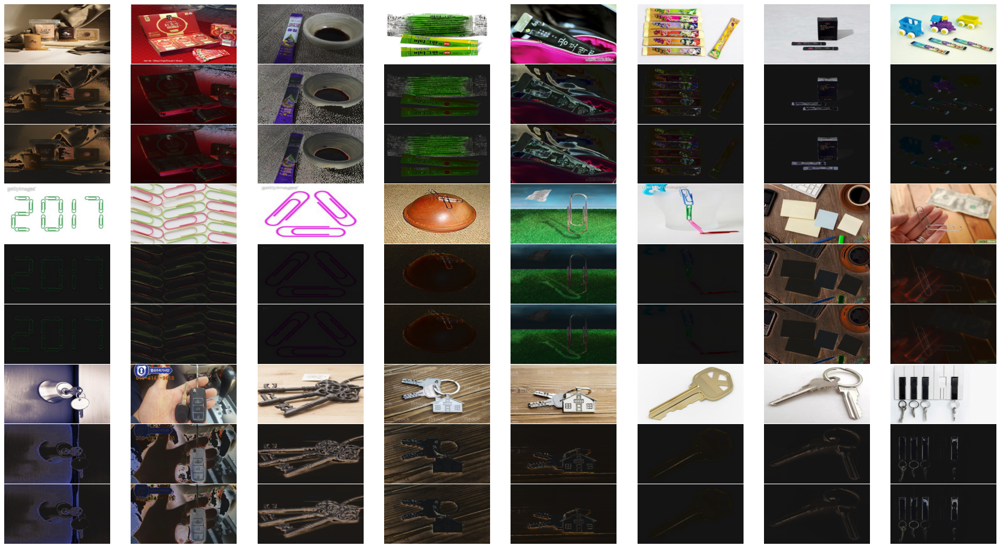

In [12]:
cols = 8
rows = 3 * cols
idx, times = 0, 3
plt.figure(figsize=(30, 22))
plt.subplots_adjust(hspace=0.01, wspace=0.04)

for i, folder in enumerate(os.listdir(data_path)):
    if i > 3:
        break
    base_folder_path = os.path.join(data_path, folder)
    if os.path.isfile(base_folder_path):
        continue

    np.random.seed(246)
    pictures = np.random.choice(os.listdir(base_folder_path), cols, replace=False)
    for n, p in enumerate(pictures):
        col = 1
        base = cv2.imread(os.path.join(base_folder_path, p))

        # * original
        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(base, cv2.COLOR_BGR2RGB))
        ax.axis("off")
        col += cols

        # * HSV - reverse + standardization
        # morning = cv2.cvtColor(base, cv2.COLOR_BGR2HSV)
        # h, s, v = cv2.split(morning)
        # dst = np.add(255 - v, 0).astype(np.uint8)
        # dst = cv2.subtract(dst, 0)
        # dst = np.exp((dst - np.mean(dst)) / np.std(dst))
        # dst = dst * 200 / np.max(dst.flatten())
        # # dst = dst.clip(20, 80)
        # img = cv2.merge((h, s, dst.astype(np.uint8)))

        # ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        # ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        # ax.axis("off")
        # col += cols

        # # * HSV - reverse + subtract + standardization
        # morning = cv2.cvtColor(base, cv2.COLOR_BGR2HSV)
        # h, s, v = cv2.split(morning)
        # dst = np.add(255 - v, 56).astype(np.uint8)
        # dst = cv2.subtract(dst, 56)
        # dst = np.exp((dst - np.mean(dst)) / np.std(dst))
        # dst = dst * 150 / np.max(dst.flatten())
        # img = cv2.merge((h, s, dst.astype(np.uint8)))

        # ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        # ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        # ax.axis("off")
        # col += cols

        # TODO choice
        # * HSV - reverse + subtract + standardization
        morning = cv2.cvtColor(base, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(morning)
        dst = np.add(255 - v, 56).astype(np.uint8)
        dst = cv2.subtract(dst, 56)
        dst = np.exp((dst - np.mean(dst)) / np.std(dst))
        dst = dst * 150 / np.max(dst.flatten())
        dst = np.add(dst, 20)
        # dst = dst.clip(20, 150)
        img = cv2.merge((h, s, dst.astype(np.uint8)))

        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        ax.axis("off")
        col += cols

        # * HSV - reverse + subtract + standardization 최소 흰색만 줄이는 방법, 필요 없을 듯
        morning = cv2.cvtColor(base, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(morning)
        dst = np.add(255 - v, 45).astype(np.uint8)
        dst = cv2.subtract(dst, 45)
        dst = np.exp((dst - np.mean(dst)) / np.std(dst))
        dst = dst * 150 / np.max(dst.flatten())
        dst = np.add(dst, 20)
        # dst = dst.clip(20, 150)
        img = cv2.merge((h, s, dst.astype(np.uint8)))

        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        ax.axis("off")
        col += cols
    idx += 1

### 만든 영상은 손을 봐야 하네?

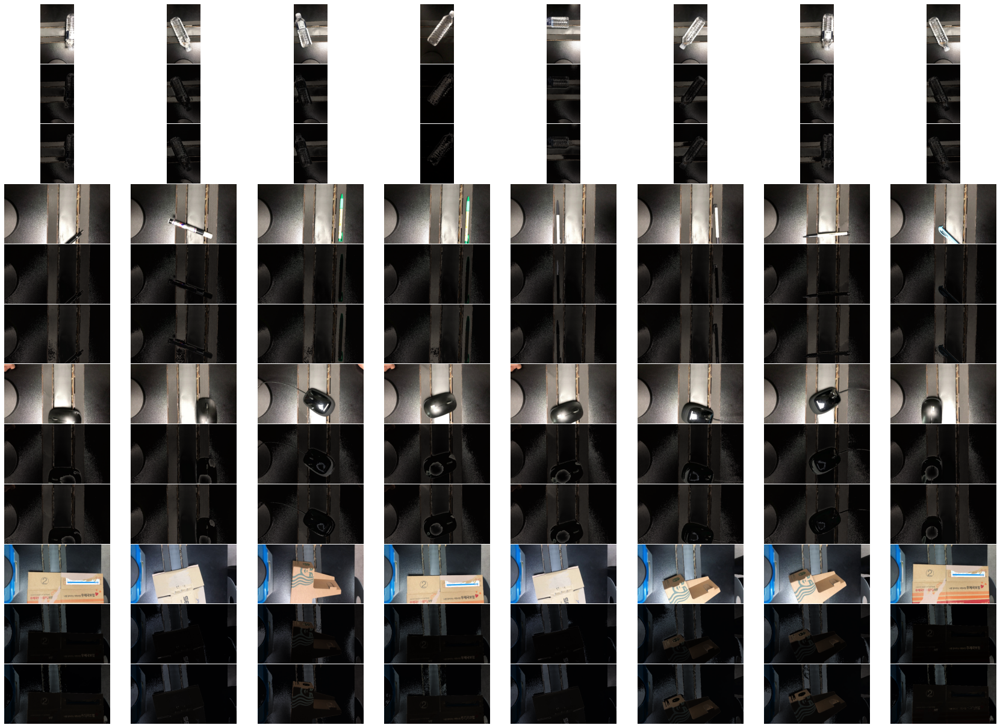

In [45]:
cols = 8
rows = 3 * cols
idx, times = 0, 3
plt.figure(figsize=(30, 22))
plt.subplots_adjust(hspace=0.01, wspace=0.04)

for i, folder in enumerate(os.listdir(data_path)):
    if i > 3:
        break
    base_folder_path = os.path.join(data_path, folder)
    if os.path.isfile(base_folder_path):
        continue

    np.random.seed(246)
    pictures = np.random.choice(os.listdir(base_folder_path), cols, replace=False)
    for n, p in enumerate(pictures):
        col = 1
        base = cv2.imread(os.path.join(base_folder_path, p))

        # * original
        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(base, cv2.COLOR_BGR2RGB))
        ax.axis("off")
        col += cols

        # * HSV - reverse + standardization
        morning = cv2.cvtColor(base, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(morning)
        dst = np.add(255 - v, 80).astype(np.uint8)
        dst = cv2.subtract(dst, 80) # 56
        dst = np.exp((dst - np.mean(dst)) / np.std(dst))
        dst = dst * 80 / np.max(dst.flatten())
        img = cv2.merge((h, s, dst.astype(np.uint8)))

        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        ax.axis("off")
        col += cols
    idx += 1

### check

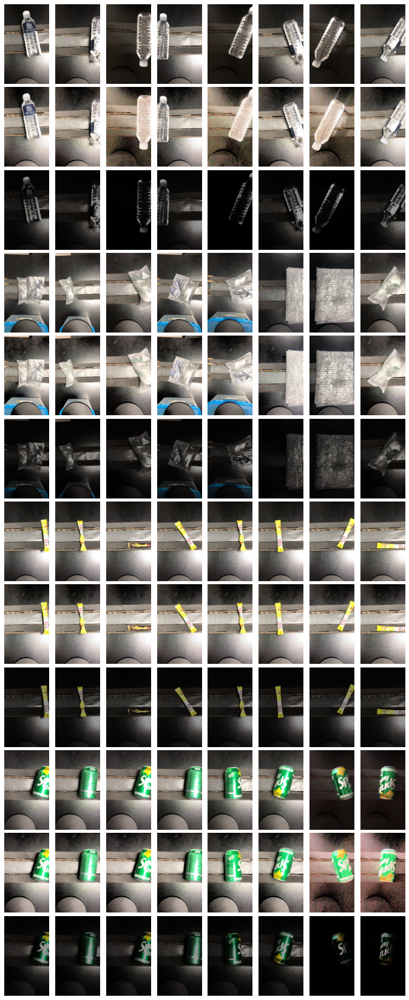

In [46]:
cols = 8
rows = 3 * cols
idx, times = 0, 3
# plt.figure(figsize=(30, 22))
plt.figure(figsize=(12, 30))
# plt.subplots_adjust(hspace=0.01, wspace=0.04)
plt.subplots_adjust(hspace=0.04, wspace=0.01)

for i, folder in enumerate(os.listdir(data_path)):
    if i in [1, 2, 3, 4, 5]:
        continue
    if idx > 3:
        break
    base_folder_path = os.path.join(data_path, folder)
    if os.path.isfile(base_folder_path):
        continue
    # print(base_folder_path, len(os.listdir(base_folder_path)))

    # np.random.seed(246)
    pictures = np.random.choice(os.listdir(base_folder_path), cols, replace=False)
    for n, p in enumerate(pictures):
        col = 1
        base = cv2.imread(os.path.join(base_folder_path, p))

        # ? original
        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(base, cv2.COLOR_BGR2RGB))
        ax.axis("off")
        col += cols

        img = cv2.cvtColor(base, cv2.COLOR_BGR2HSV)
        h, s, v = cv2.split(img)

        # ? Histogram equalization
        dst = cv2.equalizeHist(v)
        img = cv2.merge((h, s, dst))
        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        ax.axis("off")
        col += cols

        # ? representation
        dst = np.array(v)
        dst = np.exp((dst - np.mean(dst)) / np.std(dst))
        dst = dst * 150 / np.max(dst.flatten())
        img = cv2.merge((h, s, dst.astype(np.uint8)))

        ax = plt.subplot(times * 4, cols, idx * rows + col + n)
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_HSV2RGB))
        ax.axis("off")
        col += cols
    idx += 1